<a href="https://colab.research.google.com/github/NewTech-bit/DLB/blob/main/DLB_FinalDataChallenge_vFinal.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

This notebook is the final data challenge project for Deep Learning Datacamp at HSLU in September 2021. It's a group project conducted by Andreas Kläusli, Kevin Bollier, Ricky Roy Bruderer, and Xiying Liu.

## Import

First, import all the necessary packages.

In [ ]:
import os
import os.path
import pathlib
import numpy as np
import pandas as pd
import cv2
import random
import shutil
import re
import datetime

import PIL
import PIL.Image
import IPython.display as display

import tensorflow as tf
import tensorflow_datasets as tfds
from tensorflow.keras.models import Model
from tensorflow.keras import Sequential
from tensorflow.keras.layers import Conv2D, Dense, MaxPooling2D, Flatten
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.optimizers import RMSprop, Adam, SGD
from tensorflow.keras.layers import BatchNormalization

from tensorflow import keras
from tensorflow.keras import layers
from keras import applications
from keras.preprocessing import image

from keras import models, layers, optimizers, regularizers
from keras.callbacks import EarlyStopping
from keras.callbacks import ReduceLROnPlateau
from keras.layers.core import Dense, Dropout, Activation

import matplotlib.pyplot as plt
import matplotlib.image as mpimg
%matplotlib inline
%load_ext tensorboard

In [ ]:
# os.listdir()

## Load and prepare the data

### Load data from Google Drive

For this task, all data is saved in the Google Drive, so we first mounted the Google Drive to CoLab. 

Noted that this script runs properly only if the data (provided by teacher) have been uploaded and organised (in the instructed structure below) in advance.

In [ ]:
# mount google drive to colab
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


The folder structure is: first setting a folder called *DLB* (Deep Learning Bootcamp), then creating two subfolders inside *training_data* and *validation_data* for saving training and validation datasets, respectively.

In [ ]:
train_path = '/content/drive/MyDrive/DLB/training_data'
test_path = '/content/drive/MyDrive/DLB/validation_data'
train_dir = pathlib.Path(train_path)
test_dir = pathlib.Path(test_path)

### Organize folder structure to save data

The files are subsequently splitted into folders in order to enable the further preprocessing through a Keras pipeline:
- training_data
  - cat
  - dog
- validation_data
  - cat 
  - dog


In [ ]:
# restructure train folder into subfolders cat and dog
# then move labelled files into subfolders
def create_subfolders(root_path, labels):
  """
  creates subfolders for each category within the root_path folder
  :param root_path: string path with dataset in it
  :param labels: list of category labels
  """
  root = pathlib.Path(root_path)
  path_list = []
  for label in labels:
    train_label_path = root_path+"/"+label
    path_list.append(train_label_path)
    try:
      pathlib.Path(train_label_path).mkdir(parents=True, exist_ok=False)
    except FileExistsError:
      print("Folder {} is already there".format(train_label_path))
    else:
      print("Folder {} was created".format(train_label_path))
    print(path_list)
  return path_list

def files_to_subfolders(root_path, labels, path_list):
  """
  moves files into the subfolders based on filenames 'cat.XXX.jpg'
  and returns count_dict with file counts
  :root_path: path within datasets are located
  :param labels: list of category labels
  :param path_list: list of subfolder paths
  :param count_dict: dict with count of files in each subfolder
  """
  root = pathlib.Path(root_path)
  cont_var = 0
  count_dict = {"total":0}
  
  for folder in path_list:
    path = pathlib.Path(folder)
    cont_var = len(list(path.glob('*.*')))
    folder_split = folder.rsplit('/')[-1]
    count_dict[folder_split] = cont_var
    count_dict["total"] += cont_var
    if cont_var == 0:
      print("Folder {} is empty, process is ongoing".format(folder))
    else:
      print("Folder {0} already entails {1} files, check content of the folder".format(folder, count_dict[folder_split]))
      cont_var = 1
  if cont_var == 0:
    for file in root.glob('*.*.jpg'):
      folder_name = file.stem.split(".", 1)[0]
      file.rename(root /folder_name / file.name)
      count_dict[folder_name] += 1
      count_dict['total'] += 1
  else:
    print("Files could not have been moved to training subfolders")
  
  
  return count_dict

In [ ]:
# training_data: creates subfolders and moves files into them
root_path=train_path
labels=['cat','dog']
train_folders = create_subfolders(root_path=root_path, labels = labels)
train_count = files_to_subfolders(root_path=root_path, labels = labels, path_list=train_folders)

Folder /content/drive/MyDrive/DLB/training_data/cat is already there
['/content/drive/MyDrive/DLB/training_data/cat']
Folder /content/drive/MyDrive/DLB/training_data/dog is already there
['/content/drive/MyDrive/DLB/training_data/cat', '/content/drive/MyDrive/DLB/training_data/dog']
Folder /content/drive/MyDrive/DLB/training_data/cat already entails 1817 files, check content of the folder
Folder /content/drive/MyDrive/DLB/training_data/dog already entails 1699 files, check content of the folder
Files could not have been moved to training subfolders


In [ ]:
# validation_data: creates subfolders and moves files into them
root_path=test_path
labels=['cat','dog']
test_folders = create_subfolders(root_path=root_path, labels = labels)
test_count = files_to_subfolders(root_path=root_path, labels = labels, path_list=test_folders)

Folder /content/drive/MyDrive/DLB/validation_data/cat is already there
['/content/drive/MyDrive/DLB/validation_data/cat']
Folder /content/drive/MyDrive/DLB/validation_data/dog is already there
['/content/drive/MyDrive/DLB/validation_data/cat', '/content/drive/MyDrive/DLB/validation_data/dog']
Folder /content/drive/MyDrive/DLB/validation_data/cat already entails 496 files, check content of the folder
Folder /content/drive/MyDrive/DLB/validation_data/dog already entails 489 files, check content of the folder
Files could not have been moved to training subfolders


After organizing the files, we did two steps of checking:
- checking if the images are uploaded and saved in the respective folders by counting the number of images in each subfolder

- checking if the dataset is balanced between the two categories of images, by counting the number of cat images and dog images in the training and testing datasets. 

The result shows that the dataset is balanced, so we continue with data preprocessing to feed the images into TensorFlow.

In [ ]:
# define a function to count images in each subfolder
# file_path is either train_path or test_path, sub_folder is either cat or dog
def count_images(file_path, sub_folder):
  path = os.path.join(file_path, sub_folder)
  path_dir = pathlib.Path(path)
  images = path_dir.glob('*.jpg')
  num_images = len(list(images))
  return num_images

In [ ]:
num_cat_train = count_images(train_path, 'cat')
num_dog_train = count_images(train_path, 'dog')
num_cat_test = count_images(test_path, 'cat')
num_dog_test = count_images(test_path, 'dog')

print("Number of cat images in training: ", num_cat_train)
print("Number of dog images in training: ", num_dog_train)
print("Number of cat images in testing: ", num_cat_test)
print("Number of dog images in testing: ", num_dog_test)

Number of cat images in training:  1817
Number of dog images in training:  1699
Number of cat images in testing:  496
Number of dog images in testing:  489


Take a look at a sample of three images inside the training dataset.

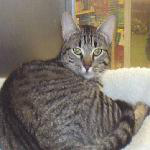

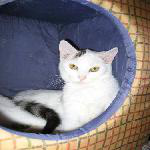

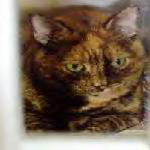

In [ ]:
for image_path in list(pathlib.Path(os.path.join(train_dir, 'cat')).glob('*.jpg'))[:3]:
  display.display(PIL.Image.open(str(image_path)))

### Preprocess data for input

This part generates a `tf.data.Dataset` from image files in a directory. Codes adopted from [TensorFlow](https://www.tensorflow.org/tutorials/images/classification).

In [ ]:
# define parameters for the loader
image_size = (150, 150)
batch_size = 64
seed = 1337

### Split the data

For the training/validation we split the data into **traind_ds** and **val_ds** and for the final evaluation we created the test data **test_ds**.


In [ ]:
# split the data into 80% for training and 20% for validation
train_ds = tf.keras.preprocessing.image_dataset_from_directory(
    train_path,
    validation_split=0.2,
    subset="training",
    seed=seed,
    image_size=image_size,
    batch_size=batch_size,
)
val_ds = tf.keras.preprocessing.image_dataset_from_directory(
    train_path,
    validation_split=0.2,
    subset="validation",
    seed=seed,
    image_size=image_size,
    batch_size=batch_size,
)

Found 3516 files belonging to 2 classes.
Using 2813 files for training.
Found 3516 files belonging to 2 classes.
Using 703 files for validation.


In [ ]:
# create test data
test_ds = tf.keras.preprocessing.image_dataset_from_directory(
    test_path,
    seed=seed,
    image_size=image_size,
    batch_size=batch_size,
)

Found 985 files belonging to 2 classes.


In [ ]:
# check the shape of input data and save it
for i in train_ds:
  print(i[0].shape)
  break

(64, 150, 150, 3)


Each batch of image is a tensor of the shape (64, 150, 150, 3), meaning each batch has 64 images, and each image's shape is 150(width)x150(height)x3(color channels). 

In [ ]:
# check the class names
class_names = train_ds.class_names
print(class_names)

['cat', 'dog']


There are two classes in the dataset as expected: cat and dog.

Then, take a look at the images.

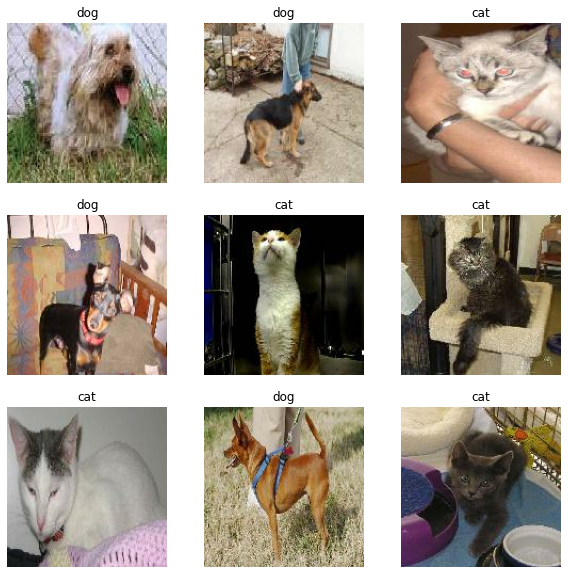

In [ ]:
# take a sample of 9 images for visulization
plt.figure(figsize=(10, 10))
for images, labels in train_ds.take(1):
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(images[i].numpy().astype("uint8"))
    plt.title(class_names[labels[i]])
    plt.axis("off")

Use methods that can configure the dataset for better performance.

In [ ]:
AUTOTUNE = tf.data.AUTOTUNE
# cache keeps images in memory after they're loaded off disk during the first epoch.
train_ds = train_ds.cache().shuffle(1000).prefetch(buffer_size=AUTOTUNE)
# prefetch overlaps data preprocessing and model execution while training
val_ds = val_ds.cache().prefetch(buffer_size=AUTOTUNE)


# Image classification: models and results

This section carries out the image classification task by using different types of models. 

As the starting point, we first built a simple *CNN model* and use it as the baseline model. Afterwards, we used more advance techniques like *image augmentation* and *transfer learning*. The result shows that *** model has the highest accuracy. 


Lastly, we predict the classification results. 

In [ ]:
# set common parameters for different types of models
input_shape = image_size + (3,)
epochs = 20

In [ ]:
input_shape

(150, 150, 3)

### Model 1: Baseline CNN model
This is a simple CNN model which is used as the baseline model for this task. Its settings are:
- Using three `Conv2D` layers, each followed by a `MaxPooling2D` layer
- Optimizer: `Adam`
- with TensorBoard

The result shows that the validation accuracy is 0.6954 given 20 epochs. After 15 epochs, it has been fluctuating between 0.65 and 0.70.

#### Define the model

In [ ]:
def model_baseline(input_shape):
  # model without data augmentation
  inputs = keras.Input(shape=input_shape)
  # entry block
  x = layers.Rescaling(1.0 / 255)(inputs)    
  x = layers.Conv2D(filters=32, kernel_size=(3, 3), activation="relu")(x)
  x = layers.MaxPooling2D(pool_size=(3, 3))(x)
  x = layers.Conv2D(filters=64, kernel_size=(3, 3), activation="relu")(x)
  x = layers.MaxPooling2D(pool_size=(3, 3))(x)
  x = layers.Conv2D(filters=128, kernel_size=(3, 3), activation="relu")(x)

# Apply global average pooling to get flat feature vectors
  x = layers.GlobalAveragePooling2D()(x)

# Add a dense classifier on top
  outputs = layers.Dense(1, activation="sigmoid")(x)
  return Model(inputs, outputs)

In [ ]:
model = model_baseline(input_shape=input_shape)
model.summary()

Model: "model_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_6 (InputLayer)         [(None, 150, 150, 3)]     0         
_________________________________________________________________
rescaling_3 (Rescaling)      (None, 150, 150, 3)       0         
_________________________________________________________________
conv2d_12 (Conv2D)           (None, 148, 148, 32)      896       
_________________________________________________________________
max_pooling2d_8 (MaxPooling2 (None, 49, 49, 32)        0         
_________________________________________________________________
conv2d_13 (Conv2D)           (None, 47, 47, 64)        18496     
_________________________________________________________________
max_pooling2d_9 (MaxPooling2 (None, 15, 15, 64)        0         
_________________________________________________________________
conv2d_14 (Conv2D)           (None, 13, 13, 128)       7385

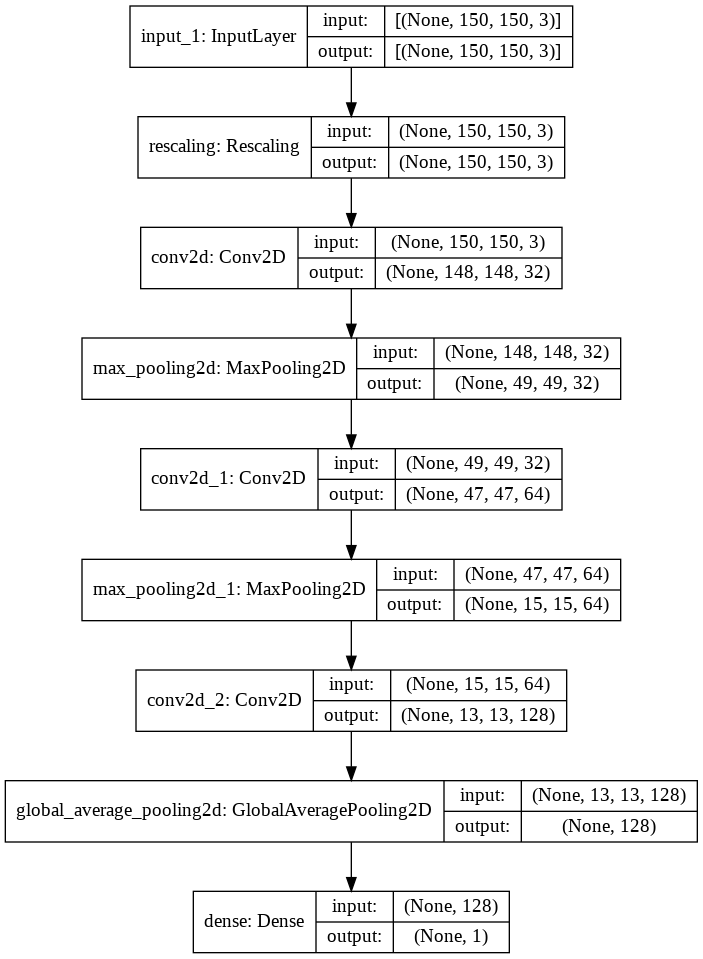

In [ ]:
# show the baseline model structure
keras.utils.plot_model(model, show_shapes=True)

#### Train the model

In [ ]:
logdir = os.path.join("logs", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))

callbacks = [keras.callbacks.ModelCheckpoint("save_at_{epoch}.h5"),
             keras.callbacks.TensorBoard(log_dir=logdir, histogram_freq=1)]

model.compile(optimizer=keras.optimizers.Adam(1e-3),
              loss="binary_crossentropy",
              metrics=["accuracy"])
# raise epochs to 30 seems to have a worse val acc, to avoid overfitting, choose 20
history = model.fit(train_ds, 
                    validation_data=val_ds, 
                    epochs=epochs, 
                    callbacks=callbacks, 
                    verbose=2)

Epoch 1/20
44/44 - 3s - loss: 0.6893 - accuracy: 0.5368 - val_loss: 0.6762 - val_accuracy: 0.5804
Epoch 2/20
44/44 - 2s - loss: 0.6656 - accuracy: 0.6004 - val_loss: 0.6572 - val_accuracy: 0.5960
Epoch 3/20
44/44 - 2s - loss: 0.6701 - accuracy: 0.5827 - val_loss: 0.6679 - val_accuracy: 0.5718
Epoch 4/20
44/44 - 2s - loss: 0.6575 - accuracy: 0.6072 - val_loss: 0.6652 - val_accuracy: 0.5932
Epoch 5/20
44/44 - 2s - loss: 0.6593 - accuracy: 0.6114 - val_loss: 0.6614 - val_accuracy: 0.6245
Epoch 6/20
44/44 - 2s - loss: 0.6420 - accuracy: 0.6317 - val_loss: 0.6433 - val_accuracy: 0.6302
Epoch 7/20
44/44 - 2s - loss: 0.6298 - accuracy: 0.6424 - val_loss: 0.6395 - val_accuracy: 0.6245
Epoch 8/20
44/44 - 2s - loss: 0.6312 - accuracy: 0.6338 - val_loss: 0.6223 - val_accuracy: 0.6600
Epoch 9/20
44/44 - 2s - loss: 0.6223 - accuracy: 0.6534 - val_loss: 0.6267 - val_accuracy: 0.6515
Epoch 10/20
44/44 - 2s - loss: 0.6035 - accuracy: 0.6630 - val_loss: 0.6084 - val_accuracy: 0.6643
Epoch 11/20
44/44 -

#### Visualize the training result

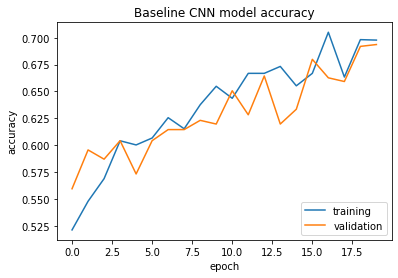

In [ ]:
# accuracy vs. epoch plot
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Baseline CNN model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['training', 'validation'], loc='lower right')
plt.show()

In [ ]:
%tensorboard --logdir logs

<IPython.core.display.Javascript object>

#### Model evaluation


In [ ]:
# evaluation on unseen test data
loss, acc = model.evaluate(test_ds)  # returns loss and metrics
print("testing loss: %.2f" % loss)
print("testing accuracy: %.2f" % acc)

16/16 [==============================] - 2s 67ms/step - loss: 0.5304 - accuracy: 0.7401
testing loss: 0.53
testing accuracy: 0.74


### Model 2: CNN Model with a kernel initializer 
Based on the baseline CNN model, this model uses:
- a kernel initializer  
- 
`SGD` optimizer

The result shows that the validation accuracy is 0.5228 after 20 epochs. Therefore, the performance is just slightly better than a "flip-a-coin" guess which has about 0.5 accuracy. 

This is confirmed by the visualization, which shows the model doesn't really learn for the validation data. However, it keeps learning for the training data. So this model shows the over-fitting problem. To avoid it, we added `Dropout` layers in the next model.

#### Define the model

In [ ]:
def model_flow():
  model = models.Sequential()
  model.add(layers.Conv2D(32, (3, 3), activation='relu', 
                          kernel_initializer='he_uniform',
                          padding='same',
                          input_shape=(150,150,3)))
  model.add(layers.MaxPooling2D((2, 2)))
  model.add(layers.Conv2D(64, (3, 3), activation='relu', 
                          kernel_initializer='he_uniform'))
  model.add(layers.MaxPooling2D((2, 2)))
  model.add(layers.Conv2D(128, (3, 3), activation='relu')) 
  model.add(Flatten())
  model.add(Dense(128, activation='relu', kernel_initializer='he_uniform'))
  model.add(Dense(1, activation='sigmoid'))
  return model

In [ ]:
model= model_flow()
model.summary()

Model: "sequential_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_6 (Conv2D)            (None, 150, 150, 32)      896       
_________________________________________________________________
max_pooling2d_4 (MaxPooling2 (None, 75, 75, 32)        0         
_________________________________________________________________
conv2d_7 (Conv2D)            (None, 73, 73, 64)        18496     
_________________________________________________________________
max_pooling2d_5 (MaxPooling2 (None, 36, 36, 64)        0         
_________________________________________________________________
conv2d_8 (Conv2D)            (None, 34, 34, 128)       73856     
_________________________________________________________________
flatten_1 (Flatten)          (None, 147968)            0         
_________________________________________________________________
dense_4 (Dense)              (None, 128)              

In [ ]:
# compile model
opt = SGD(learning_rate=2e-5)
model.compile(optimizer=opt, loss='binary_crossentropy', metrics=['accuracy'])

#### Train the model

In [ ]:
history = model.fit(train_ds, 
                    validation_data=val_ds, 
										          epochs=epochs, verbose=2)

Epoch 1/20
44/44 - 5s - loss: 14.7275 - accuracy: 0.5332 - val_loss: 0.7493 - val_accuracy: 0.5235
Epoch 2/20
44/44 - 4s - loss: 0.6978 - accuracy: 0.5631 - val_loss: 0.6883 - val_accuracy: 0.5718
Epoch 3/20
44/44 - 4s - loss: 0.6654 - accuracy: 0.5986 - val_loss: 0.6679 - val_accuracy: 0.5903
Epoch 4/20
44/44 - 4s - loss: 0.6448 - accuracy: 0.6210 - val_loss: 0.6731 - val_accuracy: 0.5960
Epoch 5/20
44/44 - 4s - loss: 0.6361 - accuracy: 0.6278 - val_loss: 0.6643 - val_accuracy: 0.5946
Epoch 6/20
44/44 - 4s - loss: 0.6256 - accuracy: 0.6410 - val_loss: 0.6584 - val_accuracy: 0.6145
Epoch 7/20
44/44 - 4s - loss: 0.6171 - accuracy: 0.6367 - val_loss: 0.6559 - val_accuracy: 0.6216
Epoch 8/20
44/44 - 4s - loss: 0.6082 - accuracy: 0.6552 - val_loss: 0.6554 - val_accuracy: 0.6188
Epoch 9/20
44/44 - 4s - loss: 0.5991 - accuracy: 0.6580 - val_loss: 0.6545 - val_accuracy: 0.6486
Epoch 10/20
44/44 - 4s - loss: 0.5914 - accuracy: 0.6690 - val_loss: 0.6419 - val_accuracy: 0.6401
Epoch 11/20
44/44 

#### Visualize the training result

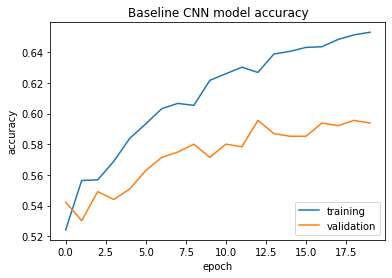

In [ ]:
# accuracy vs. epoch plot
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Baseline CNN model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['training', 'validation'], loc='lower right')
plt.show()

#### Model evaluation

In [ ]:
# evaluation on unseen test data
loss, acc = model.evaluate(test_ds)  # returns loss and metrics
print("testing loss: %.2f" % loss)
print("testing accuracy: %.2f" % acc)

16/16 [==============================] - 2s 76ms/step - loss: 0.5920 - accuracy: 0.7127
testing loss: 0.59
testing accuracy: 0.71


### Model 3: CNN model with image augmentation

Based on the baseline CNN model, we used more techniques:
- add data augmentation: horizontal flip and rotation, aiming to reduce overfitting by creating higher variations of input images.
- add `Dropout` layers, which also helps reduce overfitting.

Accuracy: 0.7411 (epochs = 20)



#### Define the model

In [ ]:
# define a data augmentation layer with horizontal and vertical flip, and rotation
data_augmentation = tf.keras.Sequential([
  tf.keras.layers.experimental.preprocessing.RandomFlip('horizontal_and_vertical'),
  tf.keras.layers.experimental.preprocessing.RandomRotation(0.2),
])

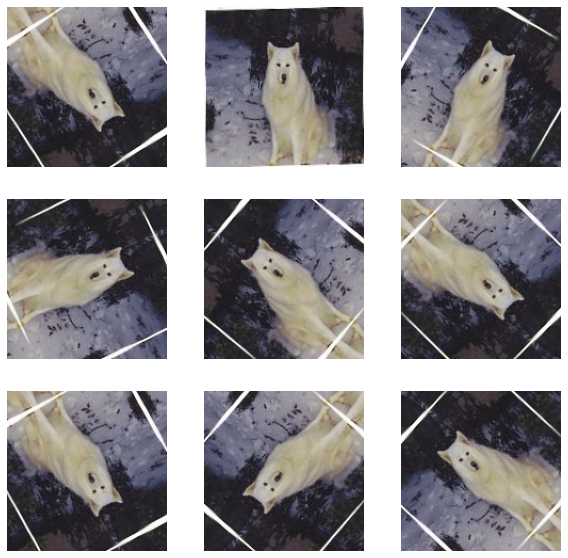

In [ ]:
# inspect the augmentation result
for image, _ in train_ds.take(1):
  plt.figure(figsize=(10, 10))
  first_image = image[0]
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    augmented_image = data_augmentation(tf.expand_dims(first_image, 0))
    plt.imshow(augmented_image[0] / 255)
    plt.axis('off')

In [ ]:
def model_augm(input_shape):
  # model with data augmentation and dropout layers
  inputs = keras.Input(shape=input_shape)
  x = data_augmentation(inputs)
  # entry block
  x = layers.Rescaling(1.0 / 255)(x)    
  x = layers.Conv2D(filters=32, kernel_size=(3, 3), activation="relu")(x)
  x = layers.MaxPooling2D(pool_size=(3, 3))(x)
  x = layers.Dropout(0.2)(x)
  x = layers.Conv2D(filters=64, kernel_size=(3, 3), activation="relu")(x)
  x = layers.MaxPooling2D(pool_size=(3, 3))(x)
  x = layers.Dropout(0.2)(x)
  x = layers.Conv2D(filters=128, kernel_size=(3, 3), activation="relu")(x)

# Apply global average pooling to get flat feature vectors
  x = layers.GlobalAveragePooling2D()(x)

# Add drop-out layer
  x = layers.Dropout(0.5)(x)

# Add a dense classifier on top
  outputs = layers.Dense(1, activation="sigmoid")(x)
  return Model(inputs, outputs)

In [ ]:
model = model_augm(input_shape=input_shape)
model.summary()

Model: "model_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_5 (InputLayer)         [(None, 150, 150, 3)]     0         
_________________________________________________________________
sequential_1 (Sequential)    (None, 150, 150, 3)       0         
_________________________________________________________________
rescaling_2 (Rescaling)      (None, 150, 150, 3)       0         
_________________________________________________________________
conv2d_9 (Conv2D)            (None, 148, 148, 32)      896       
_________________________________________________________________
max_pooling2d_6 (MaxPooling2 (None, 49, 49, 32)        0         
_________________________________________________________________
dropout_1 (Dropout)          (None, 49, 49, 32)        0         
_________________________________________________________________
conv2d_10 (Conv2D)           (None, 47, 47, 64)        1849

#### Train the model

In [ ]:
logdir = os.path.join("logs", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
callbacks = [
    keras.callbacks.ModelCheckpoint("save_at_{epoch}.h5"),
    keras.callbacks.TensorBoard(log_dir=logdir, histogram_freq=1)
]
model.compile(
    optimizer=keras.optimizers.Adam(1e-3),
    loss="binary_crossentropy",
    metrics=["accuracy"],
)

history = model.fit(
    train_ds, epochs=epochs, callbacks=callbacks, validation_data=val_ds
)

Epoch 1/20
44/44 [==============================] - 5s 89ms/step - loss: 0.6972 - accuracy: 0.4945 - val_loss: 0.6926 - val_accuracy: 0.5206
Epoch 2/20
44/44 [==============================] - 3s 58ms/step - loss: 0.6924 - accuracy: 0.5208 - val_loss: 0.6913 - val_accuracy: 0.5377
Epoch 3/20
44/44 [==============================] - 3s 61ms/step - loss: 0.6868 - accuracy: 0.5489 - val_loss: 0.6838 - val_accuracy: 0.5875
Epoch 4/20
44/44 [==============================] - 3s 60ms/step - loss: 0.6780 - accuracy: 0.5642 - val_loss: 0.6807 - val_accuracy: 0.5235
Epoch 5/20
44/44 [==============================] - 3s 60ms/step - loss: 0.6692 - accuracy: 0.5791 - val_loss: 0.6669 - val_accuracy: 0.5903
Epoch 6/20
44/44 [==============================] - 3s 59ms/step - loss: 0.6613 - accuracy: 0.6122 - val_loss: 0.6689 - val_accuracy: 0.5903
Epoch 7/20
44/44 [==============================] - 3s 59ms/step - loss: 0.6585 - accuracy: 0.5947 - val_loss: 0.6690 - val_accuracy: 0.5661
Epoch 8/20
44

#### Visualize the training result

In [ ]:
%tensorboard --logdir logs

Reusing TensorBoard on port 6006 (pid 1033), started 0:07:48 ago. (Use '!kill 1033' to kill it.)

<IPython.core.display.Javascript object>

#### Model evaluation

In [ ]:
loss, acc = model.evaluate(test_ds)  # returns loss and metrics
print("testing loss: %.2f" % loss)
print("testing acc: %.2f" % acc)

16/16 [==============================] - 2s 75ms/step - loss: 0.7405 - accuracy: 0.6244
testing loss: 0.74
testing acc: 0.62


### Model 4: Transfer learning

This model tries to fulfill the classification task by using transfer learning from a pre-trained model. 

As a pre-trained model is trained on a large and general enough dataset, it is believed that it can effectivley serve as a generic model for working with images using deep learning models.

This part is adopted from [TensorFlow](https://www.tensorflow.org/tutorials/images/transfer_learning).

##### Define the model

We will create the base model from the **MobileNet V2** model developed at Google, which is pre-trained on the ImageNet dataset with 1.4M images and 1000 classes.

First, following the common practice, we choose the *bottleneck layer*, which is the very last layer before the final flatten operation, for feature extraction.

In [ ]:
# Setting "include_top=False" meaning load a network excluding the classification layers at the top.
# Create the base model from the pre-trained model MobileNet V2
base_model = tf.keras.applications.MobileNetV2(input_shape=input_shape,
                                               include_top=False,
                                               weights='imagenet')

9420800/9406464 [==============================] - 0s 0us/step


##### Feature extraction

In [ ]:
# first freeze the convolutional base
base_model.trainable = False

In [ ]:
# understand the base model architecture
base_model.summary()

Model: "mobilenetv2_1.00_224"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, 150, 150, 3) 0                                            
__________________________________________________________________________________________________
Conv1 (Conv2D)                  (None, 75, 75, 32)   864         input_2[0][0]                    
__________________________________________________________________________________________________
bn_Conv1 (BatchNormalization)   (None, 75, 75, 32)   128         Conv1[0][0]                      
__________________________________________________________________________________________________
Conv1_relu (ReLU)               (None, 75, 75, 32)   0           bn_Conv1[0][0]                   
_______________________________________________________________________________

In [ ]:
# convert the features to a single 1280-element vector per image,
# to generate predictions from the block of features, 
# average over the spatial 5x5 spatial locations
image_batch, label_batch = next(iter(train_ds))
feature_batch = base_model(image_batch)
print(feature_batch.shape)

global_average_layer = tf.keras.layers.GlobalAveragePooling2D()
feature_batch_average = global_average_layer(feature_batch)
print(feature_batch_average.shape)

(64, 5, 5, 1280)
(64, 1280)


In [ ]:
# add a Dense layer to convert features into a single prediction per image
prediction_layer = tf.keras.layers.Dense(1) 
prediction_batch = prediction_layer(feature_batch_average)
print(prediction_batch.shape)

(64, 1)


In [ ]:
# using Function API to chain all the layers together to build the model
# setting taining=False because of BatchNormalization layer
inputs = tf.keras.Input(shape=input_shape)
x = data_augmentation(inputs)
x = layers.Rescaling(1.0 / 255)(x)
x = base_model(x, training=False)
x = global_average_layer(x)
x = tf.keras.layers.Dropout(0.2)(x)
outputs = prediction_layer(x)
model = tf.keras.Model(inputs, outputs)

In [ ]:
# compile the model
base_learning_rate = 1e-4
model.compile(optimizer=Adam(learning_rate=base_learning_rate),
              loss=tf.keras.losses.BinaryCrossentropy(from_logits=True),
              metrics=['accuracy'])

In [ ]:
model.summary()

Model: "model_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_4 (InputLayer)         [(None, 150, 150, 3)]     0         
_________________________________________________________________
sequential_1 (Sequential)    (None, 150, 150, 3)       0         
_________________________________________________________________
rescaling_1 (Rescaling)      (None, 150, 150, 3)       0         
_________________________________________________________________
mobilenetv2_1.00_224 (Functi (None, 5, 5, 1280)        2257984   
_________________________________________________________________
global_average_pooling2d_1 ( (None, 1280)              0         
_________________________________________________________________
dropout (Dropout)            (None, 1280)              0         
_________________________________________________________________
dense_3 (Dense)              (None, 1)                 1281

In [ ]:
# evaluate the model
# here epoch is set at 3 to shorten the training time, it can be raised.
feature_extraction_epochs = 3
loss, accuracy = model.evaluate(val_ds)

11/11 [==============================] - 4s 139ms/step - loss: 0.8402 - accuracy: 0.5320


In [ ]:
# output the result
print("initial loss: {:.2f}".format(loss))
print("initial accuracy: {:.2f}".format(accuracy))

initial loss: 0.84
initial accuracy: 0.53


The training result shows that after just 3 epochs, the val_accuracy has reached to more than 0.79, which is significantly better than the models before.

In [ ]:
history = model.fit(train_ds,
                    epochs=feature_extraction_epochs,
                    validation_data=val_ds)

Epoch 1/3
44/44 [==============================] - 9s 125ms/step - loss: 0.8506 - accuracy: 0.5414 - val_loss: 0.6283 - val_accuracy: 0.6899
Epoch 2/3
44/44 [==============================] - 5s 111ms/step - loss: 0.7212 - accuracy: 0.6271 - val_loss: 0.4977 - val_accuracy: 0.7895
Epoch 3/3
44/44 [==============================] - 5s 111ms/step - loss: 0.6485 - accuracy: 0.6669 - val_loss: 0.4089 - val_accuracy: 0.8364


Draw the learning curves of both training and validation loss and accuracy. The curve shows that the accuracy might keep improving if we apply more epochs.

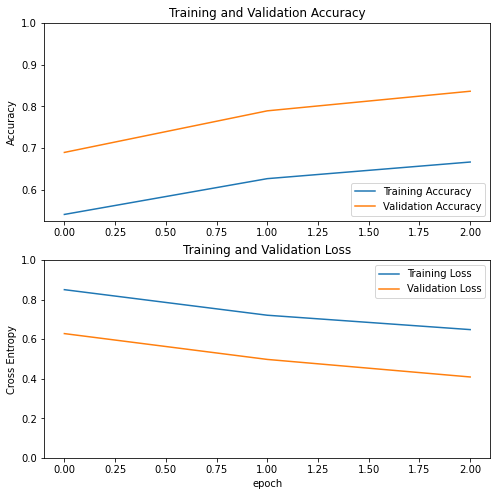

In [ ]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

plt.figure(figsize=(8, 8))
plt.subplot(2, 1, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.ylabel('Accuracy')
plt.ylim([min(plt.ylim()),1])
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.ylabel('Cross Entropy')
plt.ylim([0,1.0])
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

#### Fine tuning

The limitation of feature extraction is that it can only train a few layers on top of an MobileNet V2 base model, while the weights of the pre-trained network were not updated.

Therefore, we use fine tuning in the next step to improve the performance, by training the weights of the top layers of the pre-trained model together with the added classifier. This helps the weights to be tuned from generic features to special features in this dataset.

Noted that it is suggested to only fine-tune a small number of top layers rather than the whole pre-trained model. The reason is that in most convolutional networks, higher layers tend to extract more specialized features, while lower layers learn more generic features. 

In [ ]:
# First, un-freeze the top layers and set the bottom layers to be untrainable
base_model.trainable = True

In [ ]:
# see how many layers are in the base model
print("Number of layers in the base model: ", len(base_model.layers))

# Fine-tune from this layer onwards
fine_tune_at = 100

# Freeze all the layers before the `fine_tune_at` layer
for layer in base_model.layers[:fine_tune_at]:
  layer.trainable =  False

Number of layers in the base model:  154


In [ ]:
# visualisation with TensorBoard
logdir = os.path.join("logs", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))

callbacks = [keras.callbacks.ModelCheckpoint("save_at_{epoch}.h5"),
             keras.callbacks.TensorBoard(log_dir=logdir, histogram_freq=1)]

In [ ]:
# compile the model
model.compile(loss=tf.keras.losses.BinaryCrossentropy(from_logits=True),
              optimizer = RMSprop(learning_rate=base_learning_rate/10),
              metrics=['accuracy'])

In [ ]:
model.summary()

Model: "model_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_4 (InputLayer)         [(None, 150, 150, 3)]     0         
_________________________________________________________________
sequential_1 (Sequential)    (None, 150, 150, 3)       0         
_________________________________________________________________
rescaling_1 (Rescaling)      (None, 150, 150, 3)       0         
_________________________________________________________________
mobilenetv2_1.00_224 (Functi (None, 5, 5, 1280)        2257984   
_________________________________________________________________
global_average_pooling2d_1 ( (None, 1280)              0         
_________________________________________________________________
dropout (Dropout)            (None, 1280)              0         
_________________________________________________________________
dense_3 (Dense)              (None, 1)                 1281

In [ ]:
len(model.trainable_variables)

56

With only 2 more epochs, the val_accuracy of the fine tuning method has reached almost 0.94. As the models 1-3 have been fitted with the parameter epochs set to 20, the same setup is applied on model 4 for comparing all models. However, the testing accuracy dropped to 0.93 when the model fitted with this setup has been evaluated using the test data. As a consequence,  

In [ ]:
fine_tune_epochs = 2
total_epochs =  feature_extraction_epochs + fine_tune_epochs

history_fine = model.fit(train_ds,
                         epochs=total_epochs,
                         initial_epoch=history.epoch[-1],
                         validation_data=val_ds)

Epoch 3/5
44/44 [==============================] - 7s 160ms/step - loss: 0.0919 - accuracy: 0.9655 - val_loss: 0.1225 - val_accuracy: 0.9559
Epoch 4/5
44/44 [==============================] - 7s 158ms/step - loss: 0.0927 - accuracy: 0.9630 - val_loss: 0.1628 - val_accuracy: 0.9502
Epoch 5/5
44/44 [==============================] - 7s 158ms/step - loss: 0.0835 - accuracy: 0.9662 - val_loss: 0.1618 - val_accuracy: 0.9516


In [ ]:
%tensorboard --logdir logs

Reusing TensorBoard on port 6006 (pid 1630), started 0:10:25 ago. (Use '!kill 1630' to kill it.)

<IPython.core.display.Javascript object>

In [ ]:
# output the fine tuning results
acc += history_fine.history['accuracy']
val_acc += history_fine.history['val_accuracy']

loss += history_fine.history['loss']
val_loss += history_fine.history['val_loss']

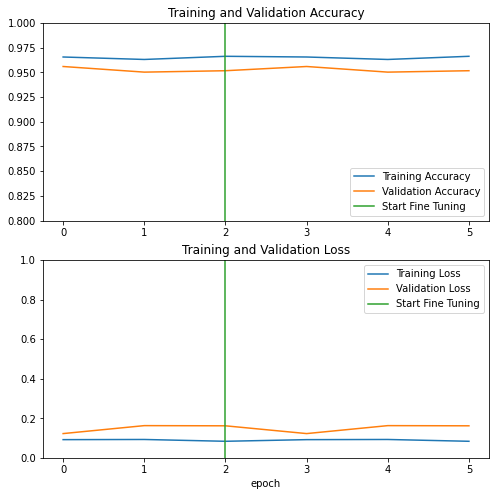

In [ ]:
# plot the accuracy and loss of both training and testing datasets
plt.figure(figsize=(8, 8))
plt.subplot(2, 1, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.ylim([0.8, 1])
plt.plot([feature_extraction_epochs-1,feature_extraction_epochs-1],
          plt.ylim(), label='Start Fine Tuning')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.ylim([0, 1.0])
plt.plot([feature_extraction_epochs-1,feature_extraction_epochs-1],
         plt.ylim(), label='Start Fine Tuning')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

#### Model evaluation

In [ ]:
# evaluation on the test data
loss, acc = model.evaluate(test_ds)  # returns loss and metrics
print("testing loss: %.2f" % loss)
print("testing accuracy: %.2f" % acc)

16/16 [==============================] - 3s 119ms/step - loss: 0.1460 - accuracy: 0.9503
testing loss: 0.15
testing accuracy: 0.95


The testing accuracy of the fine tuning model is 0.95, which is the best performance we have reached, therefore, we accept this high accuracy and use it to carry out the classification tasks on some sample images we downloaded from websites. 


## Prediction

This section we will use the fine tuning model to predict if a image is cat or dog. 


We downloaded several different types of dog and cat images and used the fine tuning model to predict their class. All images are downloaded from [Unsplash](https://unsplash.com/).

In [ ]:
# upload a sample image to classify
image_name = 'cat3.jpg'
image_path = '/content/drive/MyDrive/DLB/'
pred_path = image_path + image_name
pred_dir = pathlib.Path(pred_path)

print(image_name[0:3])

cat


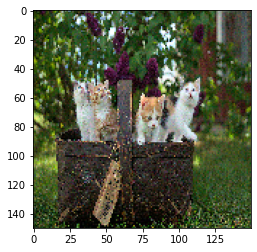

In [ ]:
img = tf.keras.utils.load_img(pred_dir, target_size = image_size)
plt.imshow(img)
plt.show()

In [ ]:
# upload a sample image to classify
image_name = 'dog3.jpg'
image_path = '/content/drive/MyDrive/DLB/'
pred_path = image_path + image_name
pred_dir = pathlib.Path(pred_path)

print(image_name[0:3])

dog


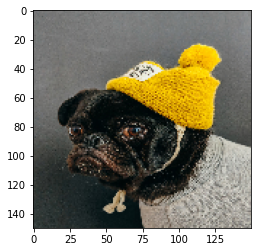

In [ ]:
img = tf.keras.utils.load_img(pred_dir, target_size = image_size)
plt.imshow(img)
plt.show()

Predictions:
 [1]


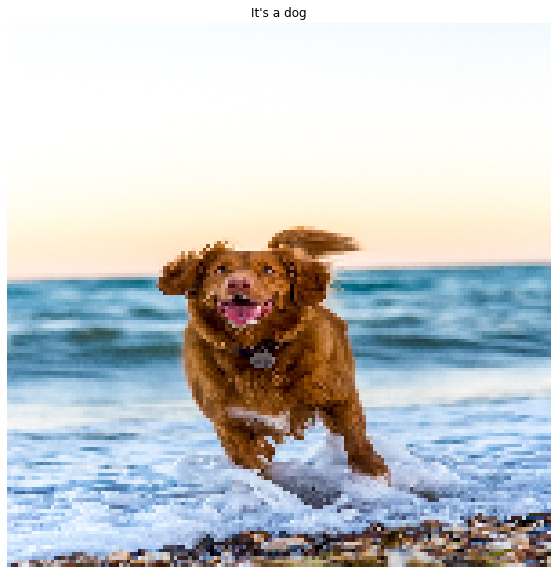

In [ ]:
from tensorflow.keras.preprocessing import image
#Retrieve a batch of images from the test set
img = image.load_img(pred_dir, target_size = image_size)
img_array = image.img_to_array(img)
image_batch = np.expand_dims(img_array, axis = 0)
#label_batch = image 

# image_batch, label_batch = test_dataset.as_numpy_iterator().next()
predictions = model.predict_on_batch(image_batch).flatten()

# Apply a sigmoid since our model returns logits
predictions = tf.nn.sigmoid(predictions)
predictions = tf.where(predictions < 0.5, 0, 1)

print('Predictions:\n', predictions.numpy())
#print('Labels:\n', label_batch)

plt.figure(figsize=(10, 10))
for i in range(1):
  # ax = plt.subplot(3, 3, i + 1)
  plt.imshow(image_batch[i].astype("uint8"))
  plt.title("It's a " + class_names[predictions[i]])
  plt.axis("off")

## Summary and learnings

### Model overview



**Model 1: CNN**

Optimizer: Adam

Test accuracy: 0.69 (epochs = 20)

---

**Model 2: CNN with kernel initializer**

Optimizer: SGD

Test accuracy: 0.52 (epochs = 20) 

---

**Model 3: CNN with augmentation**


Optimizer: Adam

Test accuracy: 0.74 (epochs = 20)

---

**Model 4: Transfer learning (MobileNet V2)**

-> fine-tuned model

Test accuracy: 0.95

---


















**Summary**

In this image classification task, we built four different types of models for the cag/dog image classification, namely a baseline CNN model, a CNN model with a kernel initializer, a CNN model with image augmentation, and a transfer learning model with both feature extraction and fine tuning, which was fed with the augmented image inputs. 

The results show that the fine tuning model has the highest accuracy which is 0.95. In practice, we should take advantage of the well pre-trained model to help us improve our model's performance. 

Furthermore, image augmentation can significantly increase the accuracy by adding more variety of the image inputs as the increase in accuracy from model 2 to model 3 shows. In addition, data augmentation is also helpful for addressing the over-fitting issues. 

By contrast, the use of the parameter "kernel initializer" and the SGD optimizer instead of the Adam optimizer for model 2 resulted in a remarkably lower accuracy than in the base model 1. It is assumed that this drop in accuracy is partly due to the choice of the kernel initializer='he_uniform' which determines the underlying distribution from which the initial weights are chosen. The impact of the kernel initializer on the accuracy is worth investigating further.

Wrong predictions: several cats, cat-ish dog
We image data set contaning only individual shots 


**Learning**

*  Preparing the inputs to feed into the CNN model is as challenging as building and running the models, if not harder. This practice helped us deepen our understandings about how to properly split the train/val/test datasets, and use the correct datasets for training and evaluating the model performance.  

* Following the steps of the model development process based on Fleuret (n.d., slide 3) provide a valuable guideline for the use of the datasets splitted into training, validation and test data

* It is pivotal to comprehend the functioning of the layers and their parameters to the extend that enables tweaking them successfully (e.g. Kernel initializer)

* transfer learning not only performs best in terms of accuracy but the learning (fitting) process runs faster than building and fitting a model from scratch









# Referencies
Fleuret, F. (n.d.). Deep learning: 2.4 Proper evaluation protocols. https://fleuret.org/dlc/materials/dlc-handout-2-4-evaluation-protocols.pdf
